# Air Quality Solutions
## Python Workshop \#3 - Air quality model data

#### Content
* Indexing and plotting 4D data
* Making an animation from model data
* Animated maps
* Unit conversion using meteorological model variables
* Plotting vertical profiles
* Masking gridded model data using `regionmask`
* Comparing model scenarios
* Binning model data using population
* Plotting model emission files

### WRF-Chem data
The data we will use in this workshop is from a model called the Weather Research and Forecasting model with chemistry, 'WRF-Chem'. 
This model was originally developed for meteorological research, and later was extended with a chemistry to represent gaseous and aerosol species in the atmosphere.

First we will import the data for this part of the workshop. In Workshop 2, we indexed data with 3 dimensions (latitude, longitude, time). This data has an additional dimension, `height`, where the with a coordinate representing height in metres. In the cell below we can see the structure of the data showing the order of the dimensions. 

In [3]:
import xarray as xr
ds = xr.open_dataset('./data/workshop_3/4d/wrfchem_feb_4d.nc')
print(ds)

<xarray.Dataset> Size: 143MB
Dimensions:  (time: 100, height: 11, lon: 81, lat: 100)
Coordinates:
  * time     (time) datetime64[ns] 800B 2015-02-01 ... 2015-02-05T03:00:00
  * height   (height) int64 88B 10 30 60 100 150 200 300 400 500 600 700
  * lon      (lon) float64 648B 100.0 100.2 100.5 100.8 ... 119.5 119.8 120.0
  * lat      (lat) float64 800B 20.1 20.35 20.6 20.85 ... 44.1 44.35 44.6 44.85
Data variables:
    pm25     (time, height, lat, lon) float32 36MB ...
    o3       (time, height, lat, lon) float32 36MB ...
    t        (time, height, lat, lon) float32 36MB ...
    p        (time, height, lat, lon) float32 36MB ...
Attributes:
    regrid_method:  bilinear


The first dimension is time, followed by height, then longitude and latitude. Because it is difficult to have a mental image of 4D data, it might be helpful to think of it as a time series of cubes, as shown in this animation of a segment of the data.

The dataset contains four variables, `pm25` ($\mathrm{PM_{2.5}}$) and `o3` (ozone), `t` (temperature) and `p` (pressure).

<img src=assets/gifs/model_animation.gif alt="segment" title="segment" width="400"/>

In this animation, the PM2.5 concentration is represented by colour, and the animation shows the concentration changing through time.

### Visualising 4D data using 2D plots
To make a 2D plot from 4D data, at least two of the dimensions need to be collapsed, either by slicing, or by performing an operation (e.g. mean, sum, standard deviation). For example, the following code first averages by time, then slices to retrieve the lowest altitude (i.e. the surface level) model gridcells, which leaves us with 2d data:



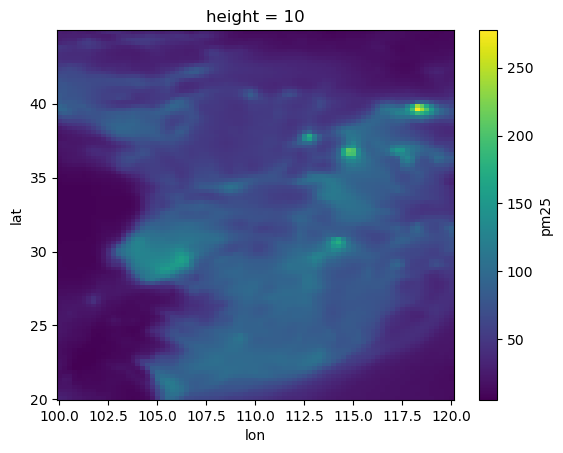

In [4]:
# average across time dimension to get 3d data
da = ds['pm25'].mean('time')
# take a slice of the lowest level of height to get 2d data
da = da[0]
da.plot()

#### <font color='red'>Question 1</font>
Using the code in Workshop 2 (in the 'Simple Maps' section), add the shapefile showing the borders of China's provinces to average PM2.5 data. Use the Orthographic projection centered on China from Workshop 2 (`ccrs.Orthographic(central_latitude=36, central_longitude=106)`)
Hint: the above data has lat-lon co-ordinates, so will need to be transformed (`transform=ccrs.PlateCarree()`).
#### <font color='green'>Answer 1</font>

<GeoAxes: title={'center': 'height = 10'}, xlabel='lon', ylabel='lat'>

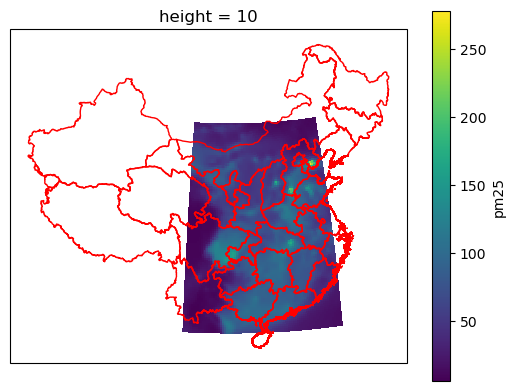

In [5]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd

ortho_proj = ccrs.Orthographic(central_latitude=36, central_longitude=106) # define the China-specific projection
provinces = gpd.read_file('./data/workshop_2/gadm41_CHN_1.shp') # load in the shapefile of China's provinces
provinces = provinces.to_crs(ortho_proj) # convert projection

fig = plt.figure()
ax = fig.add_subplot(projection=ortho_proj)
da.plot(ax=ax, transform=ccrs.PlateCarree()) # 'transform' tells it that this is lat-lon data.
provinces.plot(ax=ax, edgecolor='red', facecolor='None')

#### <font color='red'>Question 2</font>
For Question 1 we collapsed reduced the time and height dimensions, but we can also make useful plots by averaging over other dimensions. Make a plot comparing how the average PM2.5 and ozone concentrations vary with model height. However, the ozone data is in units of parts per million (ppm), so first convert this to µg m⁻³ so it is comparable with PM2.5. Use the formula: 

$
C_{\mu g/m^3} = C_{ppmv} \times \frac{P \times M}{R \times T}
$

Where P is pressure in pascals, T is temperature in Kelvin, M is the molar mass of ozone (g/mol) an R is the gas constant which is 8.3145 J/mol/K

Tips:
* you can check the units of a variable like this: `ds['t'].attrs['units']`
* when converting the units, remember to update the units attribute in the data. 
* when you need to do the same operations on multiple variables in a dataset (in this case PM2.5 and ozone), you can usually do the operations to the entire dataset.
* you can average over multiple dimensions at the same time. Here you will need to average across all dimensions except height.


#### <font color='green'>Answer 2</font>

In [6]:
# first convert the units of ozone
ds['o3'] = ds['o3'] * ( ds['p'] * 48 ) / (8.3145 * ds['t'])
ds['o3'].attrs['units'] = 'ug m^-3'

Text(0.5, 0, 'concentration [µg m⁻³]')

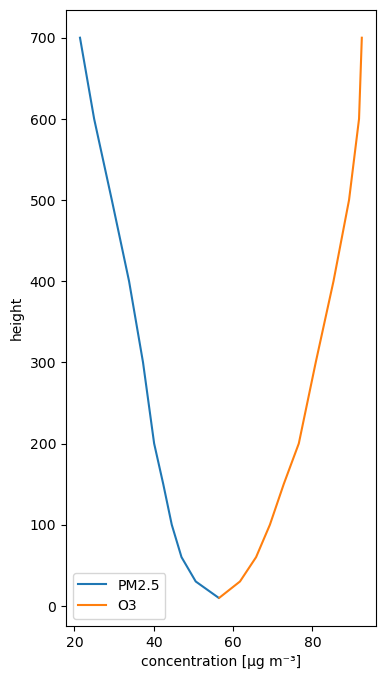

In [7]:
profiles = ds.mean(['lat', 'lon', 'time']) # calculate the mean over three dimensions, so that only height is left

fig, ax = plt.subplots(figsize=[4,8])
profiles['pm25'].plot(y='height', ax=ax, label='PM2.5') 
profiles['o3'].plot(y='height', ax=ax, label='O3')
ax.legend() # add the legend entries as defined by 'label='
ax.set_xlabel('concentration [µg m⁻³]')

### Making an animation

Creating a gif or video from model data is a useful way to gain an understanding of the processes represented in atmospheric chemistry models.

One way of creating an animation is using a matplotlib's `FuncAnimation` function. In this method, you create the a matplotlib figure as normal, that contains the data for the first frame of the animation. Then, you write a function, to which you supply the frame number as the argument, that uses this to update the data in the figure. Then you supply both figure and animation function to `FuncAnimation`, which then creates and saves the video.

For this part, we will load in a 3D model dataset with a longer time series but without a height dimension. This data only contains PM2.5 levels from the surface (lowest model level). Here is an example of creating a simple animation from this data.

In [8]:
ds = xr.open_dataset('./data/workshop_3/hourly/wrfchem_aug.nc')

Here is a simple example:

In [9]:
import matplotlib.animation as animation
from IPython.display import HTML

# get a time series of average pm2.5 by latitude by averaging over lon
da = ds['pm25'].mean('lon')

fig, ax = plt.subplots(figsize=[4,5])
lines = da[0].plot(ax=ax) # store the output of the plot in a variable called lines

def update(frame_number):
    ydata = da[frame_number] # use the frame number to select the data for each time step
    lines[0].set_ydata(ydata) # then the line can be updated by the function each frame
    return lines

ani = animation.FuncAnimation(fig=fig, func=update, frames=200, interval=50)
plt.close(fig)
HTML(ani.to_jshtml())

#### <font color='red'>Question 3</font>
Sometimes, creating an animation from model data output can be the best way to understand the large-scale dynamics behind variation in air quality across your domain. **Identify the two meteorological features that have a noticable impact in in the model data file `wrfchem_aug.nc`.** The first occurs around August 7th, the second August 12th.

Use the above code along with code from previous sections of the notebook to make an animated cholopleth map of surface PM2.5 levels. Include the borders of China's provinces, and a colourbar legend. Restrict the area plotted to between latitude 20N-45N and longitude 100E-125E. Add the coastlines to the plot by using `ax.coastlines`, and choose an appropriate map projection. 

Hints:
* instead of updating the values of a line as in the previous code, you will have to update the values of the grid.
* use `HTML(ani.to_jshtml())` to display your animation in this notebook
* It may take a while to generate the animation. If it takes too long, reduce the number of frames being generated.
* in your `update` function, remember to update the plot title with the date, which can be found in the `time` coordinate of the DataArray

#### <font color='green'>Answer 3</font>
Typhoon and dust storm

In [10]:
da = ds['pm25'].loc[{'lat':slice(20,45), 'lon':slice(100,125)}]

ortho_proj = ccrs.Orthographic(central_latitude=36, central_longitude=106)

fig = plt.figure()
ax = fig.add_subplot(projection=ortho_proj)
ax.coastlines(color='white')
im = da[0].plot(ax=ax)

def update(frame_number):
    array = da[frame_number]
    im.set_array(array)
    ax.set_title(da[frame_number].coords['time'].values.astype(str)[:10])
#    print('!', end='')
    return im

ani = animation.FuncAnimation(fig=fig, func=update, frames=300, interval=50)
plt.close(fig)
#ani.save('./wrfchem_animation.gif')

HTML(ani.to_jshtml())


### Model scenarios

Using atmospheric chemistry models allows us to test different scenarios by changing the model inputs and seeing how the atmospheric chemistry responds. Inputs that can easily be changed usually include emissions, land cover, weather, and chemical reaction rates. By modifying these, we can explore all kind of scenarios such as:
* What would the effect on ozone levels be if the land occupied by trees doubled in the UK?
* How would a warmer and wetter future change PM2.5 levels in India?
* If a country adopted all possible air quality control policies, how much would its air quality improve by?

Usually, we run a 'control' scenario, which is our best estimate of real-world conditions, and then compare this with one or more 'counterfactual' scenarios. In this part of the workshop we will use three WRF-Chem model output files that are in the `./data/workshop_3/scenarios/` directory. These represent three different scenarios that have each been run with different [ECLIPSE emissions](https://iiasa.ac.at/models-tools-data/global-emission-fields-of-air-pollutants-and-ghgs) scenarios.
* `wrfchem_ecpCLE2015`: A WRF-Chem simulation emissions based on current legislation (CLE) in 2015, i.e. a baseline scenario that estimates the emissions under business as usual.
* `wrfchem_ecpCLE2050`: A WRF-Chem simulation run with an estimate for emissions in 2050 if no new air quality legislation is brought in.
* `wrfchem_ecpMFR2050`: A WRF-Chem simulation using 2050 emissions that estimate the maximum feasible reduction (MFR) in air quality emissions under a scenario in which all possible air quality control policies are enacted.

Each of the files contains the monthly average concentrations for PM2.5, O3, NO2 and SO2. It also contains the meteorological variables, pressure and temperature. The simulations are all run with weather conditions from 2015. This allows us to isolated the effects of the changes in emissions, without having the difference in 2015 and (projected) 2050 weather as a confounding variable. _Note that even for the 2050 files, the datetimeindex is the months during 2015, to make comparisons easier_

#### <font color='red'>Question 3</font>
We have 3 files, each file has 4 pollutant variables, each of which is a 3D DataArray. But since DataArrays aren't designed for hierachical indexing (e.g. pandas MultiIndex), we can't easily merge all the files into one Dataset. In this case, an easy way to store the files together is in a dictionary. This is a cleaner approach that having different python variables for each file.

**Load the datasets into a dictionary called `scenarios`, with the filenames (minus the extension) as your dictionary keys. As you are loading the files, use the mask to remove data outside China. 

We can use the `regionmask` package to use the China provinces shapefile to conveniently create a mask for the model data:

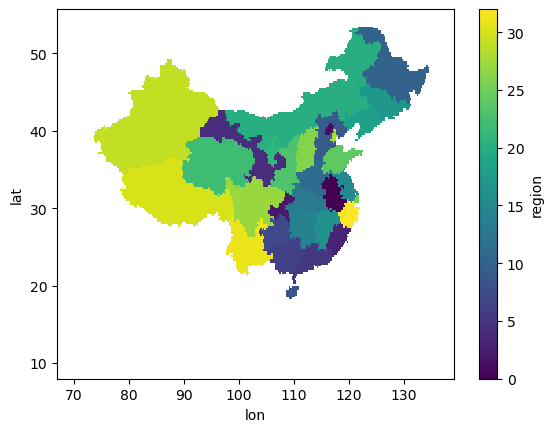

In [11]:
import regionmask
# open China provinces shapefile
provinces = gpd.read_file('./data/workshop_2/gadm41_CHN_1.shp')
provinces = provinces.dissolve('NAME_1') # merge the geometries by name
# load one of the datasets to use as a template for the mask
ds = xr.open_dataset('./data/workshop_3/scenarios/wrfchem_ecpCLE2015.nc')
# create the regionmask
provinces_regionmask = regionmask.from_geopandas(provinces.reset_index(), 
                                           names='NAME_1', abbrevs='HASC_1')
# use the regionmask to create a raster mask which uses ds as its template
mask = provinces_regionmask.mask(ds)
mask.plot()

Now we have a raster mask that exactly matches our model dataset. Using `.where()` (see Workshop 2) we can mask the data from all of China or individual provinces.

#### <font color='green'>Answer 3</font>

In [12]:
# load in the files
from glob import glob
filepaths = glob('./data/workshop_3/scenarios/wrfchem*.nc')
scenarios = {} # create a dictionary to store the scenarios
for filepath in filepaths:
    ds = xr.open_dataset(filepath)
    ds = ds.where(mask.notnull()) # this masks the dataset for all of China
    scenarios[filepath.split('_')[-1][:-3]] = ds # add each scenario to the dictionary

print(scenarios)

{'ecpCLE2015': <xarray.Dataset> Size: 16MB
Dimensions:  (month: 12, lat: 191, lon: 289)
Coordinates:
  * month    (month) int64 96B 1 2 3 4 5 6 7 8 9 10 11 12
  * lat      (lat) float64 2kB 8.1 8.35 8.6 8.85 9.1 ... 54.85 55.1 55.35 55.6
  * lon      (lon) float64 2kB 67.0 67.25 67.5 67.75 ... 138.2 138.5 138.8 139.0
Data variables:
    pm25     (month, lat, lon) float32 3MB nan nan nan nan ... nan nan nan nan
    o3       (month, lat, lon) float32 3MB nan nan nan nan ... nan nan nan nan
    no2      (month, lat, lon) float32 3MB nan nan nan nan ... nan nan nan nan
    so2      (month, lat, lon) float32 3MB nan nan nan nan ... nan nan nan nan
    T2       (month, lat, lon) float32 3MB nan nan nan nan ... nan nan nan nan
    pres     (month, lat, lon) float32 3MB nan nan nan nan ... nan nan nan nan
Attributes:
    regrid_method:  bilinear, 'ecpCLE2050': <xarray.Dataset> Size: 16MB
Dimensions:  (month: 12, lat: 191, lon: 289)
Coordinates:
  * month    (month) int64 96B 1 2 3 4 5 6 7 8 9 

#### <font color='red'>Question 4</font>
Before doing any further analysis, we need to ensure that all the variables are in the same units. Currently, PM$\mathrm{_{2.5}}$ is in units of $\mathrm{\micro g\ m^{-3}}$, and the gaseous variables are in units of ppmv (parts per million by volume). The formula to convert from $\mathrm{\micro g\ m^{-3}}$ to ppmv is:

$
C_{\mu g m^{-3}} = C_{ppmv} \times \frac{P \times M}{R \times T}
$

Where $P$ is pressure in Pascals, $M$ is molar mass in $g\ mol^{-1}$, R is the universal gas constant (8.3145) and $T$ is temperature in $K$

This formula can be written as a python function:
```python
def ppm_to_ugm3(ppmv, M_gmol):
    R = 8.3145  # J mol^-1 K^-1
    ugm3 = ppmv * (100000 * M_gmol) / (R * 298.15)
    return ugm3 
```
This function uses 'standard' temperature and pressure, which are commonly used values in the absence of data. However, our WRF-Chem model data includes these variables. 

**Update the function to accept arguments for pressure and temperature, so that you can use the temperature and pressure variables to convert the units of NO2, O3 and SO2 to $\mathrm{\micro g\ m^{-3}}$**

Hints:
* The units present in the WRF-Chem data might not match those needed for the formula.
* $M$ is different for each compound
* Remember to update the variables units attribute (`da.attrs['units']`) after converting
* A dictionary of the molar masses for each species will be useful:
```python
M = {'no2':46.01,
     'so2':64.07,
     'o3':48.}
```


#### <font color='green'>Answer 5</font>

In [13]:
M = {'no2':46.01,
     'so2':64.07,
     'o3':48.}

def ppm_to_ugm3(ppmv, pressure_pa, temperature_k, M_gmol):
    R = 8.3145  # J mol^-1 K^-1
    ugm3 = ppmv * (pressure_pa * M_gmol) / (R * temperature_k)
    return ugm3 

for scenario, ds in scenarios.items():
    for pol in ['no2', 'o3', 'so2']:
        ugm3 = ppm_to_ugm3(ppmv=ds[pol], 
                           pressure_pa=ds['pres'] * 100, # convert to Pa
                           temperature_k=ds['T2'] + 273.15, # convert to K
                           M_gmol=M[pol]
                          )
        ds[pol] = ugm3
        ds[pol].attrs['units'] = 'ug m^-3'
    # need to update the dictionary afterwards
    scenarios[scenario] = ds

    
    

#### <font color='red'>Question 5</font>
First, make a plot showing the % change (relative to 2015 values) from 2015 to 2050 between the two scenarios. Since there are four pollutants, and two 2050 scenarios, your plot should have 8 panels, showing the difference between the 2015 baseline scenario and the future scenarios in terms of annual mean.

Hints:
* Use the `ccrs.Orthographic(central_latitude=36, central_longitude=106)` projection for the maps
* converting the `provinces` geodataframe to this projection before plotting will be quicker
* Plot the provinces of China on each map.
* Use a red-blue colourmap, with to represent increase (red) or decrease (blue) in concentrations
* Have all the plots share the same colourmap
* Adjust the axes limits with `ax.set_extent()` to remove the unnecessary whitespace from each plot
* To adjust the spacing of the subplots use `fig.subplots_adjust()`

  

Now, using the skills learnt in previous workshops, we can answer the following questions:

1. What province contains the gridcell where annual mean NO2 levels will most increase (in absolute terms) by 2050 in the current legislation scenario?
Hints:
* To find the maximum value, stack the dataarray and then use idxmax
* To find which province contains the maximum value, use `provinces.contains` with a `shapely.Point`
2. What are the three provinces where NO2 levels decrease most on average during JJA (June, July, August) in the maximum feasible reduction scenario compared with the baseline?

Hints:
* In this case, since each province doesn't span a large latitude, it is ok to ignore the fact that gridcells vary in size, so there is no need to area weight your averages.
* Use `provinces_regionmask` and `mask` to extract values from each province. To find the value that corresponds to a province on the mask, use the `.map_keys()` method.
* to make 8 subplots all with the same map projection, use subplot_kw={'projection':china_proj}` in `plt.subplots()`
* you can limit the extent of the map by using `ax.set_extent()`
  

#### <font color='green'>Answer 5</font>

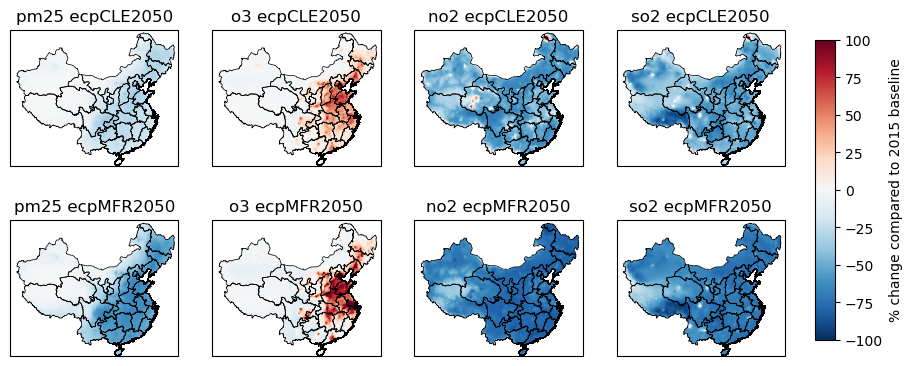

In [14]:
china_proj = ccrs.Orthographic(central_latitude=36, central_longitude=106)
provinces_orth = provinces.to_crs(china_proj)

fig, axes = plt.subplots(2,4, subplot_kw={'projection':china_proj}, # give all the axes the same projection
                        figsize=[10,6])
for axrowi, scenario in enumerate(['ecpCLE2050', 'ecpMFR2050']): # iterate over the two future scenarios
    ds = scenarios[scenario]
    for axcoli, pol in enumerate(['pm25', 'o3', 'no2', 'so2']): # iterate over all the pollutants
        ax = axes[axrowi, axcoli]

        
        diff = ds[pol] - scenarios['ecpCLE2015'][pol]  # calc difference
        percent_diff = (diff / scenarios['ecpCLE2015'][pol]) * 100 # convert to percent difference
        percent_diff = percent_diff.mean('month') # reduce the time dimension by taking mean to make the data 2D
        
        q = percent_diff.plot(ax=ax, transform=ccrs.PlateCarree(),
                              add_colorbar=False, cmap='RdBu_r', vmin=-100, vmax=100)
        provinces_orth.plot(ax=ax, facecolor='None', edgecolor='black', lw=.5) # plot the provinces

        # limit the extent of the map
        westlimit=78; southlimit=17; eastlimit=127; northlimit=53 
        ax.set_extent([westlimit, eastlimit, southlimit, northlimit], crs=ccrs.PlateCarree())

        ax.set_title(f'{pol} {scenario}')

fig.subplots_adjust(hspace=-.3)
fig.colorbar(q, cax=fig.add_axes([.93, .25, .02, .5]), label='% change compared to 2015 baseline')

In [15]:
from shapely import Point
import numpy as np
import pandas as pd
import calendar

### 1 ###
# take difference of the scenarios
diff = scenarios['ecpCLE2050']['no2'].mean('month') - scenarios['ecpCLE2015']['no2'].mean('month')
# find lat and lon of maximum value
max_idx = diff.stack(z=('lat', 'lon')).idxmax("z")
lat_max = max_idx["lat"].item()
lon_max = max_idx["lon"].item()
# find which province shapefile contains maximum value
answer = provinces.loc[provinces.contains(Point(lon_max, lat_max))].index[0]
print('The province that contains the gridcell with the largest absolute NO2 increase is', answer)

### 2 ###
# take difference of scenarios
diff = scenarios['ecpMFR2050']['no2'] - scenarios['ecpCLE2015']['no2']
# extract JJA and take mean
diff = diff.loc[{'month':[12,1,2]}].mean('month')
no2_by_province = pd.Series(index=provinces.index)
for province in provinces.index:
    prov_mask_value = provinces_regionmask.map_keys(province)
    mean_no2 = diff.where(mask==prov_mask_value).mean()
    no2_by_province.loc[province] = mean_no2

print('The three provinces where NO2 decrease the most on average during JJA are\n', no2_by_province.nsmallest(3))

The province that contains the gridcell with the largest absolute NO2 increase is Nei Mongol
The three provinces where NO2 decrease the most on average during JJA are
 NAME_1
Shanghai   -67.088272
Tianjin    -66.398766
Shandong   -55.383232
dtype: float64


### Binning and visualising gridded data.
Gridded data stored in `DataArray`s can easy be binned and visualised as histograms to compare distributions. `DataArrays` have a built-in `.plot.hist()` method which can be used like this:

Text(0, 0.5, 'frequency')

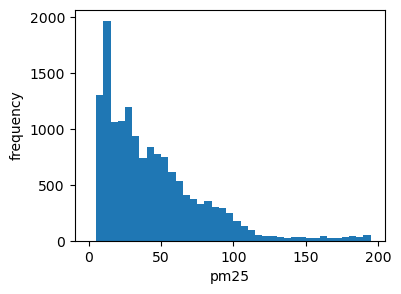

In [16]:
ds = scenarios['ecpCLE2015']
fig, ax = plt.subplots(figsize=[4,3])
_ = ds['pm25'].mean('month').plot.hist(bins=np.arange(0,200,5)) #'_ =' discards the output so it isn't printed below
ax.set_ylabel('frequency')

To compare two distributions on the same plot, you can make the bars semitransparent using the `alpha` argument

Text(0, 0.5, 'frequency')

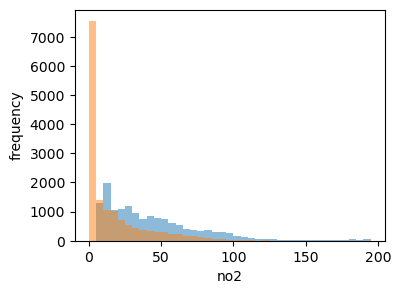

In [17]:
fig, ax = plt.subplots(figsize=[4,3])
_ = ds['pm25'].mean('month').plot.hist(bins=np.arange(0,200,5), alpha=.5)
_ = ds['no2'].mean('month').plot.hist(bins=np.arange(0,200,5), alpha=.5)
ax.set_ylabel('frequency')

#### <font color='red'>Question 5</font>
As you can see from the maps made in Question 4, PM2.5 concentrations are expected to decrease in both scenarios. In the `./data/workshop_3/scenarios/` directory, there is also a `population.nc` file. Load this data in, and use it to examine how the exposure is forecast to change in the future model scenarios.

The WHO currently stipulates that annual mean PM2.5 exposure should be below 5 ug m-3 to avoid adverse health impacts. It also sets intermediate targets (ITs) to aim towards while countries try to meet this goal. The targets for the 'AQG', 'IT-4', 'IT-3', 'IT-2', and 'IT-1' are 5, 10, 15, 25 and 35, respectively.

AQG: 5
IT-4: 10
IT-3: 15
IT-2: 25
IT-1: 35

**a) According to the model simulations, how many more people will be living in an with an exposure that complies with each target under the two future scenarios?**
**b) by how much does the PM2.5 population-weighted mean decrease in the maximum feasible reduction scenario compared with the current legislation scenario by 2050.**

Create a figure which displays this information. You can create any type of figure that depicts this. Assume that the population distribution in 2050 is the same as in 2015. To create the figure, sum the population that live below each target, e.g. 0-5, 5-10, 10-15 etc., for each scenario.

Hints:
* Using the [`groupby_bins()`](https://docs.xarray.dev/en/latest/generated/xarray.DataArray.groupby_bins.html) method of `DataArray`s will make this much easier! Use it to group the population data according to the PM2.5 data by the specified bins
* A useful example of how to make a grouped bar chart: https://matplotlib.org/stable/gallery/lines_bars_and_markers/barchart.html. You can base your code on this example
* In (b), `da.weighted` can be used to make calculating population weighted mean easier, see [the documentation here](https://docs.xarray.dev/en/stable/generated/xarray.DataArray.weighted.html)

#### <font color='green'>Answer 5</font>

/tmp/ipykernel_28725/2722219362.py:21: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(aqgs.index)


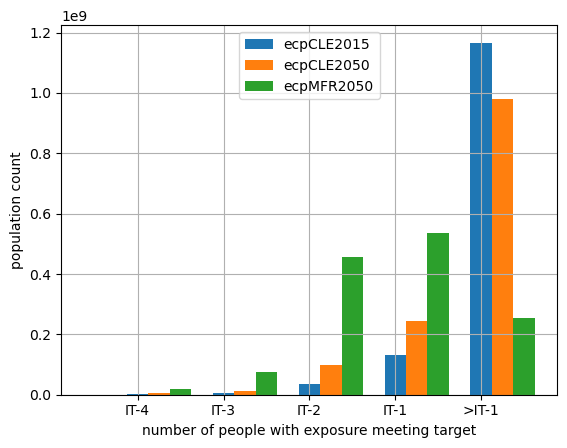

In [18]:
# make the aqgs into a pandas Series
aqgs = pd.Series([5, 10, 15, 25, 35, 9999],
                 index=['AQG', 'IT-4', 'IT-3', 'IT-2', 'IT-1', '>IT-1'])
population = xr.open_dataset('./data/workshop_3/scenarios/population.nc')

x = np.arange(len(aqgs))  # the label locations
width = 0.25  # the width of the bars
multiplier = 0

fig, ax = plt.subplots()
for scenario, ds in scenarios.items():
    offset = width * multiplier # code from the penguin example
    da = population['population_count'].groupby_bins(ds['pm25'].mean('month'), # reduce over time
                                                     bins=[0]+list(aqgs.values)).sum()
    

    rects = ax.bar(x + offset, da.values, width, label=scenario)
    multiplier += 1

ax.legend()
ax.set_xticklabels(aqgs.index)
ax.set_ylabel('population count')
ax.set_xlabel('number of people with exposure meeting target')
ax.grid()

In [19]:
cle = scenarios['ecpCLE2050']['pm25'].weighted(population['population_count']).mean()
mfr = scenarios['ecpMFR2050']['pm25'].weighted(population['population_count']).mean()

print(f'In the CLE scenario, population-weighted PM2.5 is {round(float(cle), 2)} ug/m3 in 2050')
print(f'In the MFR scenario, population-weighted PM2.5 is {round(float(mfr), 2)} ug/m3 in 2050')
print(f'So with maximum feasible reduction, population-weighted PM2.5 decreases by {round(float(cle-mfr), 2)} ug/m3')

In the CLE scenario, population-weighted PM2.5 is 49.39 ug/m3 in 2050
In the MFR scenario, population-weighted PM2.5 is 27.87 ug/m3 in 2050
So with maximum feasible reduction, population-weighted PM2.5 decreases by 21.51 ug/m3


### Model emission files

One of the auxillary files needed to run an atmospheric chemistry model are 'emissions' files. These contain data of the rate of emissions for different chemical compounds. When the model runs, emissions are injected into the surface layer (i.e. the lowest altitude gridcells), and can then be mixed through the model domain.

#### <font color='red'>Question 6</font>

An example emission file for NH3 (Ammonia) is in this workshops data folder under `./emissions/NH3_emissions.nc`. The file contains emissions broken down by sector. The units of emission files are usually expressed as a rate, e.g. mass per area per second. In this case, they are $\mathrm{kg\ m^{-2}\ s^{-1}}$. The grid is regular (in terms of latitude and longitude), with a resolution of 0.1 degrees

Therefore, to calculate the total mass of emissions over a year, the values must be multiplied by the area per gridcell and the number of seconds in a year.

**Write code to calculate the total emissions per year in Tg then make a pie chart of the % emissions by sector. What is the total NH3 emissions in kg (sum of all sectors), and what percentage is agriculture of this?**

To calculate this, you will first need to estimate the area in m^2 of each grid cell. The equation below can be used to estimate this assuming a spherical Earth

$$
A = R^2 \cdot \Delta \lambda \cdot (\sin \phi_2 - \sin \phi_1)
$$
$$
\begin{aligned}
\text{where:} \\
A & \text{ is the area of the grid cell (m²),} \\
R & \text{ is Earth's radius } (\approx 6,371,000 \text{ m}), \\
\Delta \lambda & \text{ is the grid cell width in radians } \left(\Delta \lambda = \text{longitude resolution} \times \frac{\pi}{180} \right), \\
\phi_1 & \text{ is the southern boundary of the grid cell in radians } \left(\phi_1 = \left(\text{latitude} - \frac{\text{latitude resolution}}{2} \right) \times \frac{\pi}{180} \right), \\
\phi_2 & \text{ is the northern boundary of the grid cell in radians } \left(\phi_2 = \left(\text{latitude} + \frac{\text{latitude resolution}}{2} \right) \times \frac{\pi}{180} \right).
\end{aligned}
$$

Here is the start of a python function that can be used to calculate gridcell area for a regular latitude longitude grid. Finish off the function by filling in the code in the function's loop, and use this to answer the question.

```python
def calculate_gridcell_area(da, resolution):
    areas = xr.DataArray(coords=da.coords) #  create a duplicate empty DataArray
    lats = ds.lat.values
    for lat in lats:
        # CALCULATE AREA FOR LATITUDE (A)
        #
        #
        areas.loc[{'lat':lat}] = A
    
    return areas
```

Hints:
* When you have calculated the totals by sector, you will have a dataset that can be easily converted into a pandas series using `.to_pandas()`. Pandas has a plotting method `.plot.pie()` which makes it easy to plot a pie chart.

#### <font color='green'>Answer 6</font>

the total annual emissions of NH3 in China is 10.07 Tg
the agricultural sector accounts for 94.3%


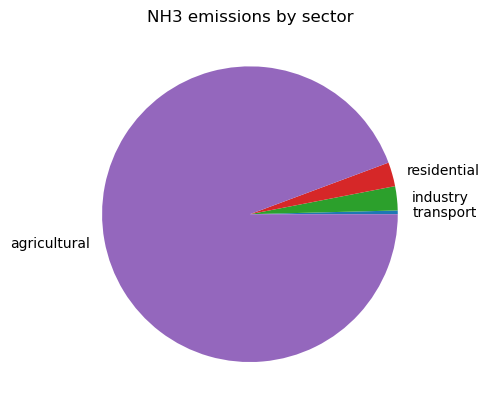

In [20]:
ds = xr.open_dataset('./data/workshop_3/emissions/NH3_emis.nc')

resolution = .1

def calculate_gridcell_areas(ds, resolution):
    areas = xr.DataArray(coords=ds.coords) #  create a duplicate empty DataArray
    lats = ds.lat.values
    R = 6371000
    for lat in lats:
        A = R**2 * np.deg2rad(resolution) * (np.sin(np.deg2rad(lat+resolution/2)) - np.sin(np.deg2rad(lat-resolution/2))) 
        areas.loc[{'lat':lat}] = A
    return areas

# get the array of areas
areas = calculate_gridcell_areas(ds, resolution=.1)


# convert to kg
seconds_in_year = 60*60*24*364
ds_kg = ds * areas * seconds_in_year

total = float(np.sum(ds_kg.to_array()).values)
sector_totals = ds_kg.sum().to_pandas() # converting to pandas makes plotting easier
sector_totals.index = ['transport', 'energy', 'industry', 'residential', 'agricultural']

fig, ax = plt.subplots()
sector_totals.plot.pie()
ax.set_title('NH3 emissions by sector')

print(f'the total annual emissions of NH3 in China is {round(total/1e9, 2)} Tg')
agr_percent = sector_totals['agricultural'] / float(total) * 100
print(f'the agricultural sector accounts for {round(agr_percent, 1)}%')